## The contents include:

* 1. Reading CEL files
* 2. Building the ExpressionSet object
* 3. Handling the AffyBatch object
* 4. Checking the quality of data
* 5. Generating artificial expression data
* 6. Data normalization

## 1. Reading CEL files

The CEL file contains all the intensity-related information of the pixels(including the intensity itself, the standard deviation, the number of pixels, and other meta information) on the array. Every experiment usually has more than one sample and replicates, so there will be one CEL file present for each sample or replicated file. The CEL files must be read to get the data in a workable format in the R workspace. To do the first step of microarray data analysis, as an example, we will use the NCBI GEO database for a simple dataset on breast cancer. 
“CEL”文件包含像素的所有强度相关信息（包括强度本身，标准偏差，像素的数量和其他元信息）。每个实验通常都有多个样本并进行复制，所以每个样本或复制文件都会有一个“CEL”文件。必须读取“CEL”文件才能在R工作区中以可行的格式获取数据。为了完成微阵列数据分析的第一步，我们使用NCBI GEO数据库作为乳腺癌的简单数据集作为例子。

At first, download `GSE24460` from [NCBI GEO](http://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE24460). This will give a file named `GSE24460_RAW.tar` in desired directory. But I run in windows operating sysytem, then use the `type = "win.binary"`. 
Unzip this file to get CEL files. The files have also been provided with the code files the sub directory `<GSE24460_RAW>`.<br>
首先在NCBI GEO数据库里下载‘GSE24460’文件，下载完成，在目标路径下获得的是文件压缩包，需要解压缩，获得‘.CEL’格式的文件。

In [2]:
if (!requireNamespace("BiocManager", quietly = TRUE))
install.packages("BiocManager")

BiocManager::install("affy")
BiocManager::install("affydata")
BiocManager::install("hgu133a2cdf")

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'affy'



package 'affy' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\Master\AppData\Local\Temp\RtmpS4zWmb\downloaded_packages


Old packages: 'BH', 'bit', 'caTools', 'cli', 'fansi', 'GetoptLong', 'ggridges',
  'gplots', 'hms', 'multcomp', 'mvtnorm', 'precrec', 'prettyunits', 'pROC',
  'RCurl', 'RSQLite', 'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun',
  'zoo'

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'affydata'

installing the source package 'affydata'


Old packages: 'BH', 'bit', 'caTools', 'cli', 'fansi', 'GetoptLong', 'ggridges',
  'gplots', 'hms', 'multcomp', 'mvtnorm', 'precrec', 'prettyunits', 'pROC',
  'RCurl', 'RSQLite', 'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun',
  'zoo'

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'hgu133a2cdf'

installing the source package 'hgu133a2cdf'


Old packages: 'BH', 'bit', 'caTools', 'cli', 'fansi', 'GetoptLong', 'ggridges',
  'gplots', 'hms', 'multcomp', 'mvtnorm', 'precrec', 'prettyunits', 'pROC',
  'RCurl', 'RSQLite', 'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex

In [2]:
library(affy)
library(affydata)
library(hgu133a2cdf)

In [3]:
mydata <- ReadAffy(celfile.path= "F:/GSE24460_RAW/")
mydata <- ReadAffy(filenames="F:/GSE24460_RAW/GSM602658_MCF71.CEL")

mydata

AffyBatch object
size of arrays=732x732 features (18 kb)
cdf=HG-U133A_2 (22277 affyids)
number of samples=1
number of genes=22277
annotation=hgu133a2
notes=

In [4]:
if(require(affydata)){
    celpath <- system.file("celfiles", package="affydata")
     fns <- list.celfiles(path=celpath,full.names=TRUE)
     cat("Reading files:\n",paste(fns,collapse="\n"),"\n")
     abatch <- ReadAffy(filenames=fns[1])                # read a binary celfile
     abatch <- ReadAffy(filenames=fns[2])                # read a text celfile
     abatch <- ReadAffy(celfile.path=celpath)            # read all files in that dir 
}

Reading files:
 D:/R-3.6.2/library/affydata/celfiles/binary.cel
D:/R-3.6.2/library/affydata/celfiles/text.cel 


## 2. Building the ExpressionSet object

In [5]:
# BiocManager::install("Biobase")
library(Biobase)

In [6]:
DIR <- system.file("extdata", package="Biobase")
exprsLoc <- file.path(DIR, "exprsData.txt") 
pDataLoc <- file.path(DIR, "pData.txt")
DIR
exprsLoc
pDataLoc

[1] "D:/R-3.6.2/library/Biobase/extdata"

[1] "D:/R-3.6.2/library/Biobase/extdata/exprsData.txt"

[1] "D:/R-3.6.2/library/Biobase/extdata/pData.txt"

In [7]:
exprs <- as.matrix(read.csv(exprsLoc, header = TRUE, sep = "\t", row.names = 1, as.is = TRUE))
exprs

,A,B,C,D,E,F,G,H,I,J,...,Q,R,S,T,U,V,W,X,Y,Z
AFFX-MurIL2_at,192.7420,85.75330,176.7570,135.57500,64.49390,76.35690,160.5050,65.96310,56.90390,135.608000,...,179.84500,152.46700,180.83400,85.41460,157.98900,146.8000,93.8829,103.85500,64.4340,175.61500
AFFX-MurIL10_at,97.1370,126.19600,77.9216,93.37130,24.39860,85.50880,98.9086,81.69320,97.80150,90.483800,...,87.68060,108.03200,134.26300,91.40310,-8.68811,85.0212,79.2998,71.65520,64.2369,78.70680
AFFX-MurIL4_at,45.8192,8.83135,33.0632,28.70720,5.94492,28.29250,30.9694,14.79230,14.23990,34.487400,...,32.79110,33.52920,19.81720,20.41900,26.87200,31.1488,22.3420,19.01350,12.1686,17.37800
AFFX-MurFAS_at,22.5445,3.60093,14.6883,12.33970,36.86630,11.25680,23.0034,16.21340,12.03750,4.549780,...,15.94880,14.67530,-7.91911,12.88750,11.91860,12.8324,11.1390,7.55564,19.9849,8.96849
AFFX-BioB-5_at,96.7875,30.43800,46.1271,70.93190,56.17440,42.67560,86.5156,30.79270,19.71830,46.352000,...,58.62390,114.06200,93.44020,22.51680,48.64620,90.2215,42.0053,57.57380,44.8216,61.70440
AFFX-BioB-M_at,89.0730,25.84610,57.2033,69.97660,49.58220,26.12620,75.0083,42.33520,41.12070,91.530700,...,58.13310,104.12200,115.83100,58.12240,73.42210,64.6066,40.3068,41.82090,46.1087,49.41220
AFFX-BioB-3_at,265.9640,181.08000,164.9260,161.46900,236.97600,156.80300,211.2570,235.99400,175.64000,229.671000,...,192.22100,305.56700,300.68900,146.08100,142.91300,187.1320,170.5830,133.27900,187.4070,144.78400
AFFX-BioC-5_at,110.1360,57.28890,67.3980,77.22070,41.34880,37.97800,110.5510,47.76900,24.78750,66.730200,...,53.27110,107.23700,119.66600,24.06540,98.84250,92.0846,53.3866,52.01640,65.9154,75.00430
AFFX-BioC-3_at,43.0794,16.80060,37.6002,46.52720,22.24750,61.64010,33.6623,31.44230,23.10080,39.741900,...,57.50780,41.13370,79.98290,23.49530,51.56090,48.1247,31.8358,29.92640,37.8611,60.47720
AFFX-BioDn-5_at,10.9187,16.17890,10.1495,9.73639,16.90280,5.33328,25.1182,38.75760,31.40410,0.398779,...,21.50910,3.10536,5.95347,5.66012,52.93380,15.7267,15.2116,-5.35282,13.1884,10.03850


In [8]:
class(exprs)

dim(exprs)

pData <- read.table(pDataLoc, row.names = 1, header = TRUE, sep = "\t")
pData

pData <- new("AnnotatedDataFrame", data = pData)
pData

exData <- new("MIAME", name="ABCabc", lab="XYZ Lab", contact="abc@xyz", title="", abstract="", url="www.xyz")
exData

exampleSet <- new("ExpressionSet", exprs = exprs, phenoData = pData, experimentData = exData, annotation = "hgu133a2")
exampleSet

[1] "matrix"

[1] 500  26

,gender,type,score
,<fct>,<fct>,<dbl>
A,Female,Control,0.75
B,Male,Case,0.40
C,Male,Control,0.73
D,Male,Case,0.42
E,Female,Case,0.93
F,Male,Control,0.22
G,Male,Case,0.96
H,Male,Case,0.79
I,Female,Case,0.37


An object of class 'AnnotatedDataFrame'
  rowNames: A B ... Z (26 total)
  varLabels: gender type score
  varMetadata: labelDescription

Experiment data
  Experimenter name: ABCabc 
  Laboratory: XYZ Lab 
  Contact information: abc@xyz 
  Title:  
  URL: www.xyz 
  PMIDs:  
  No abstract available.

ExpressionSet (storageMode: lockedEnvironment)
assayData: 500 features, 26 samples 
  element names: exprs 
protocolData: none
phenoData
  sampleNames: A B ... Z (26 total)
  varLabels: gender type score
  varMetadata: labelDescription
featureData: none
experimentData: use 'experimentData(object)'
Annotation: hgu133a2 

In [9]:
str(exampleSet)

validObject(exampleSet)

Formal class 'ExpressionSet' [package "Biobase"] with 7 slots
  ..@ experimentData   :Formal class 'MIAME' [package "Biobase"] with 13 slots
  .. .. ..@ name             : chr "ABCabc"
  .. .. ..@ lab              : chr "XYZ Lab"
  .. .. ..@ contact          : chr "abc@xyz"
  .. .. ..@ title            : chr ""
  .. .. ..@ abstract         : chr ""
  .. .. ..@ url              : chr "www.xyz"
  .. .. ..@ pubMedIds        : chr ""
  .. .. ..@ samples          : list()
  .. .. ..@ hybridizations   : list()
  .. .. ..@ normControls     : list()
  .. .. ..@ preprocessing    : list()
  .. .. ..@ other            : list()
  .. .. ..@ .__classVersion__:Formal class 'Versions' [package "Biobase"] with 1 slot
  .. .. .. .. ..@ .Data:List of 2
  .. .. .. .. .. ..$ : int [1:3] 1 0 0
  .. .. .. .. .. ..$ : int [1:3] 1 1 0
  ..@ assayData        :<environment: 0x000000002b2aef78> 
  ..@ phenoData        :Formal class 'AnnotatedDataFrame' [package "Biobase"] with 4 slots
  .. .. ..@ varMetadata     

[1] TRUE

## 3. Handling the AffyBatch object

In [10]:
library(affy)
library(hgu133a2cdf)

In [11]:
mydata <- ReadAffy(filenames="F:/GSE24460_RAW/GSM602658_MCF71.CEL")
mydata

AffyBatch object
size of arrays=732x732 features (18 kb)
cdf=HG-U133A_2 (22277 affyids)
number of samples=1
number of genes=22277
annotation=hgu133a2
notes=

In [12]:
str(mydata)
pData(mydata)
phenoData(mydata)
exprs(mydata)


annotation(mydata)

probeNames(mydata)


write.csv(probeNames(mydata), file = "D:/Try-practice/Chapter 5/probenames.csv")  # 读出数据



 sampleNames(mydata)

Your code contains a unicode char which cannot be displayed in your
current locale and R will silently convert it to an escaped form when the
R kernel executes this code. This can lead to subtle errors if you use
such chars to do comparisons. For more information, please see
https://github.com/IRkernel/repr/wiki/Problems-with-unicode-on-windows

Formal class 'AffyBatch' [package "affy"] with 10 slots
  ..@ cdfName          : chr "HG-U133A_2"
  ..@ nrow             : Named int 732
  .. ..- attr(*, "names")= chr "Rows"
  ..@ ncol             : Named int 732
  .. ..- attr(*, "names")= chr "Cols"
  ..@ assayData        :<environment: 0x000000001210bda0> 
  ..@ phenoData        :Formal class 'AnnotatedDataFrame' [package "Biobase"] with 4 slots
  .. .. ..@ varMetadata      :'data.frame':	1 obs. of  1 variable:
  .. .. .. ..$ labelDescription: chr "arbitrary numbering"
  .. .. ..@ data             :'data.frame':	1 obs. of  1 variable:
  .. .. .. ..$ sample: int 1
  .. .. ..@ dimLabels        : chr [1:2] "sampleNames" "sampleColumns"
  .. .. ..@ .__classVersion__:Formal class 'Versions' [package "Biobase"] with 1 slot
  .. .. .. .. ..@ .Data:List of 1
  .. .. .. .. .. ..$ : int [1:3] 1 1 0
  ..@ featureData      :Formal class 'AnnotatedDataFrame' [package "Biobase"] with 4 slots
  .. .. ..@ varMetadata      :'data.frame':	0 obs. of  

,sample
,<int>
GSM602658_MCF71.CEL,1


An object of class 'AnnotatedDataFrame'
  sampleNames: GSM602658_MCF71.CEL
  varLabels: sample
  varMetadata: labelDescription

,GSM602658_MCF71.CEL
1,88
2,7068
3,99
4,7452
5,87
6,80
7,7794
8,101
9,7493
10,95


[1] "hgu133a2"

[1] "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"  
    [6] "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"  
   [11] "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"   "1007_s_at"  
   [16] "1007_s_at"   "1053_at"     "1053_at"     "1053_at"     "1053_at"    
   [21] "1053_at"     "1053_at"     "1053_at"     "1053_at"     "1053_at"    
   [26] "1053_at"     "1053_at"     "1053_at"     "1053_at"     "1053_at"    
   [31] "1053_at"     "1053_at"     "117_at"      "117_at"      "117_at"     
   [36] "117_at"      "117_at"      "117_at"      "117_at"      "117_at"     
   [41] "117_at"      "117_at"      "117_at"      "117_at"      "117_at"     
   [46] "117_at"      "117_at"      "117_at"      "121_at"      "121_at"     
   [51] "121_at"      "121_at"      "121_at"      "121_at"      "121_at"     
   [56] "121_at"      "121_at"      "121_at"      "121_at"      "121_at"     
   [61] "121_at"      "121_at"      "121_at"      "121_at"      "1255_g_at"  
   [66] "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"  
   [71] "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"  
   [76] "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"   "1255_g_at"  
   [81] "1294_at"     "1294_at"     "1294_at"     "1294_at"     "1294_at"    
   [86] "1294_at"     "1294_at"     "1294_at"     "1294_at"     "1294_at"    
   [91] "1294_at"     "1294_at"     "1294_at"     "1294_at"     "1294_at"    
   [96] "1294_at"     "1316_at"     "1316_at"     "1316_at"     "1316_at"    
  [101] "1316_at"     "1316_at"     "1316_at"     "1316_at"     "1316_at"    
  [106] "1316_at"     "1316_at"     "1316_at"     "1316_at"     "1316_at"    
  [111] "1316_at"     "1316_at"     "1320_at"     "1320_at"     "1320_at"    
  [116] "1320_at"     "1320_at"     "1320_at"     "1320_at"     "1320_at"    
  [121] "1320_at"     "1320_at"     "1320_at"     "1320_at"     "1320_at"    
  [126] "1320_at"     "1320_at"     "1320_at"     "1405_i_at"   "1405_i_at"  
  [131] "1405_i_at"   "1405_i_at"   "1405_i_at"   "1405_i_at"   "1405_i_at"  
  [136] "1405_i_at"   "1405_i_at"   "1405_i_at"   "1405_i_at"   "1405_i_at"  
  [141] "1405_i_at"   "1405_i_at"   "1431_at"     "1431_at"     "1431_at"    
  [146] "1431_at"     "1431_at"     "1431_at"     "1431_at"     "1431_at"    
  [151] "1431_at"     "1431_at"     "1431_at"     "1431_at"     "1431_at"    
  [156] "1431_at"     "1431_at"     "1431_at"     "1438_at"     "1438_at"    
  [161] "1438_at"     "1438_at"     "1438_at"     "1438_at"     "1438_at"    
  [166] "1438_at"     "1438_at"     "1438_at"     "1438_at"     "1438_at"    
  [171] "1438_at"     "1438_at"     "1438_at"     "1438_at"     "1487_at"    
  [176] "1487_at"     "1487_at"     "1487_at"     "1487_at"     "1487_at"    
  [181] "1487_at"     "1487_at"     "1487_at"     "1487_at"     "1487_at"    
  [186] "1487_at"     "1487_at"     "1487_at"     "1487_at"     "1487_at"    
  [191] "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"  
  [196] "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"  
  [201] "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"   "1494_f_at"  
  [206] "1494_f_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"  
  [211] "1598_g_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"  
  [216] "1598_g_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"   "1598_g_at"  
  [221] "1598_g_at"   "1598_g_at"   "160020_at"   "160020_at"   "160020_at"  
  [226] "160020_at"   "160020_at"   "160020_at"   "160020_at"   "160020_at"  
  [231] "160020_at"   "160020_at"   "160020_at"   "160020_at"   "160020_at"  
  [236] "160020_at"   "160020_at"   "160020_at"   "1729_at"     "1729_at"    
  [241] "1729_at"     "1729_at"     "1729_at"     "1729_at"     "1729_at"    
  [246] "1729_at"     "1729_at"     "1729_at"     "1729_at"     "1729_at"    
  [251] "1729_at"     "1729_at"     "1729_at"     "1729_at"     "177_at"     
  [256] "177_at"      "177

Warning message in file(file, ifelse(append, "a", "w")):
"cannot open file 'D:/Try-practice/Chapter 5/probenames.csv': No such file or directory"


ERROR: Error in file(file, ifelse(append, "a", "w")): cannot open the connection


## 4. Checking the quality of data

In [15]:
BiocManager::install("arrayQualityMetrics")

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'arrayQualityMetrics'

also installing the dependency 'beadarray'




package 'beadarray' successfully unpacked and MD5 sums checked
package 'arrayQualityMetrics' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\Master\AppData\Local\Temp\RtmpMfLr8M\downloaded_packages


Old packages: 'BH', 'bit', 'caTools', 'cli', 'FactoMineR', 'fansi', 'farver',
  'GetoptLong', 'ggridges', 'gplots', 'hms', 'knitr', 'leaps', 'multcomp',
  'mvtnorm', 'PMA', 'precrec', 'prettyunits', 'pROC', 'RCurl', 'RSQLite',
  'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun', 'XML', 'xts', 'zoo'



In [16]:
library(affy)
library(arrayQualityMetrics)

In [17]:
mydata <- ReadAffy(celfile.path= "F:/GSE24460_RAW/")
mydata

AffyBatch object
size of arrays=732x732 features (19 kb)
cdf=HG-U133A_2 (22277 affyids)
number of samples=4
number of genes=22277
annotation=hgu133a2
notes=

In [18]:
arrayQualityMetrics(mydata, outdir="F:/quality_assesment")

The directory 'F:/quality_assesment' has been created.

Warning message in svgStyleAttributes(style, svgdev):
"Removing non-SVG style attribute name(s): subscripts, group.number, group.value"
Warning message in svgStyleAttributes(style, svgdev):
"Removing non-SVG style attribute name(s): subscripts, group.number, group.value"
Warning message in svgStyleAttributes(style, svgdev):
"Removing non-SVG style attribute name(s): subscripts, group.number, group.value"
Warning message in svgStyleAttributes(style, svgdev):
"Removing non-SVG style attribute name(s): subscripts, group.number, group.value"
(loaded the KernSmooth namespace)

Warning message in KernSmooth::bkde2D(x, gridsize = nbin, bandwidth = bandwidth):
"Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'"
Warning message in KernSmooth::bkde2D(x, gridsize = nbin, bandwidth = bandwidth):
"Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'"
Warning message in KernSm

In [19]:
BiocManager::install("hexbin")
library(hexbin)

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'hexbin'



package 'hexbin' successfully unpacked and MD5 sums checked


Warning message:
"cannot remove prior installation of package 'hexbin'"
Warning message in file.copy(savedcopy, lib, recursive = TRUE):
"problem copying D:\R-3.6.2\library\00LOCK\hexbin\libs\x64\hexbin.dll to D:\R-3.6.2\library\hexbin\libs\x64\hexbin.dll: Permission denied"
Warning message:
"restored 'hexbin'"



The downloaded binary packages are in
	C:\Users\Master\AppData\Local\Temp\RtmpMfLr8M\downloaded_packages


Old packages: 'BH', 'bit', 'caTools', 'cli', 'FactoMineR', 'fansi', 'farver',
  'GetoptLong', 'ggridges', 'gplots', 'hms', 'knitr', 'leaps', 'multcomp',
  'mvtnorm', 'PMA', 'precrec', 'prettyunits', 'pROC', 'RCurl', 'RSQLite',
  'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun', 'XML', 'xts', 'zoo'



In [20]:
browseURL("F:/quality_assesment/index.html")

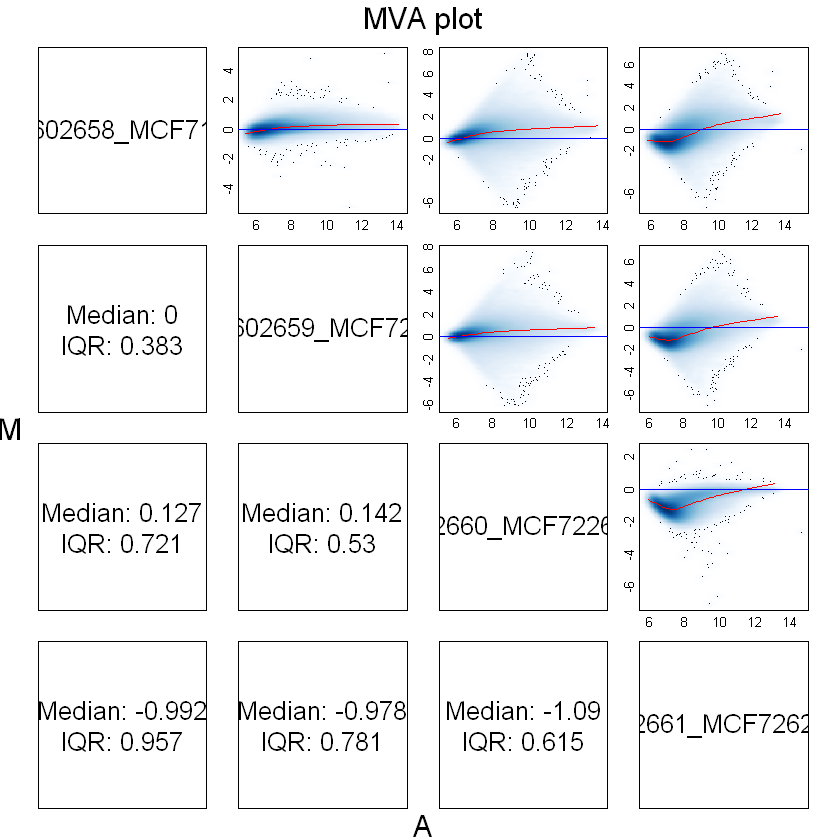

In [21]:
MAplot(mydata, pairs=TRUE, plot.method="smoothScatter")

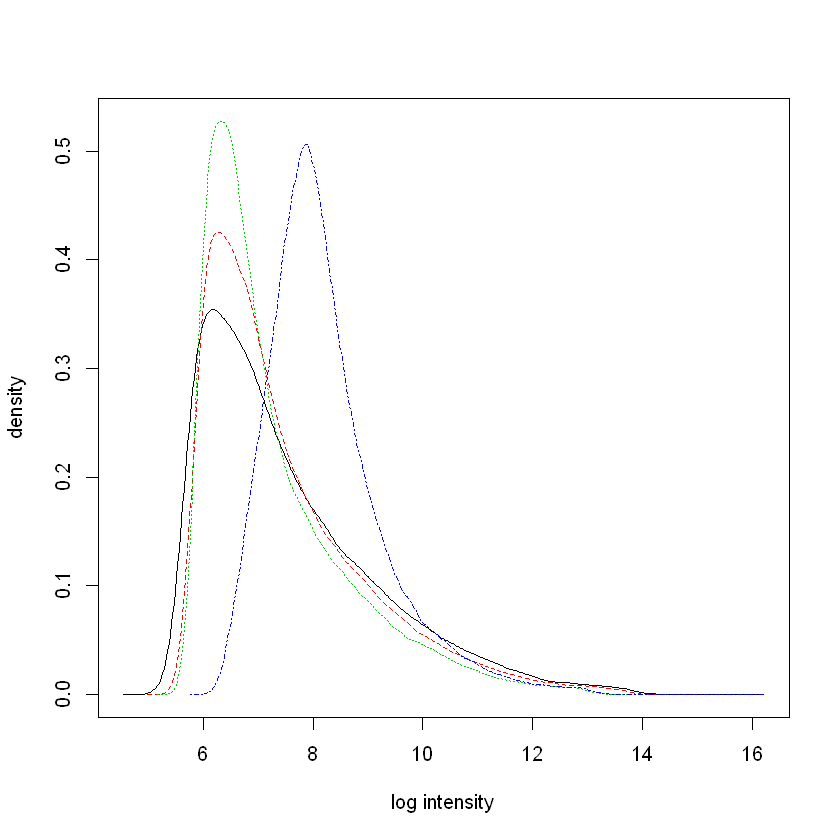

In [22]:
plotDensity.AffyBatch(mydata)

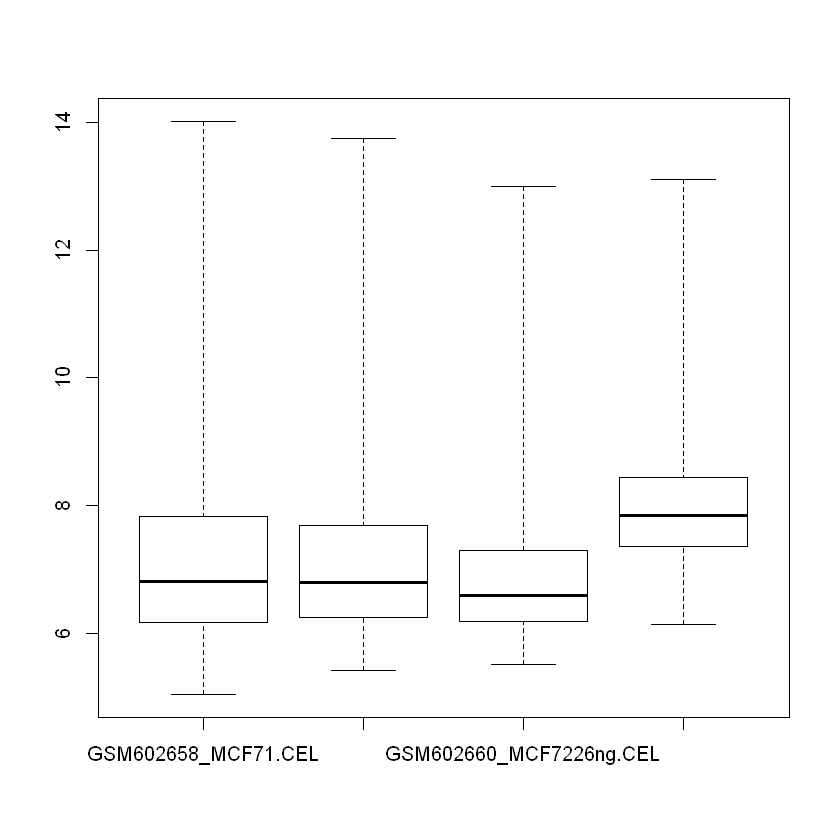

In [23]:
boxplot(mydata)

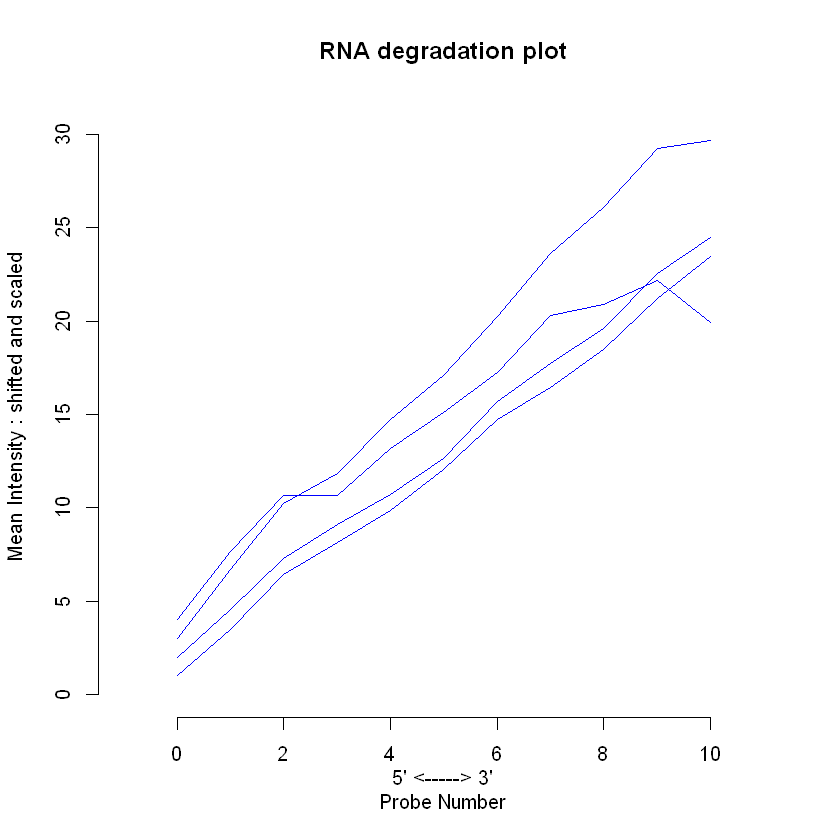

In [24]:
rnaDeg <- AffyRNAdeg(mydata)
plotAffyRNAdeg(rnaDeg)

In [25]:
summaryAffyRNAdeg(rnaDeg)

,GSM602658_MCF71.CEL,GSM602659_MCF72.CEL,GSM602660_MCF7226ng.CEL,GSM602661_MCF7262ng.CEL
slope,2.19e+00,2.22e+00,2.73e+00,1.74e+00
pvalue,2.87e-13,5.01e-13,3.40e-11,1.51e-06


## 5. Generating artificial expression data

In [26]:
BiocManager::install("madsim")
library(madsim)

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'madsim'



package 'madsim' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\Master\AppData\Local\Temp\RtmpMfLr8M\downloaded_packages


Old packages: 'BH', 'bit', 'caTools', 'cli', 'FactoMineR', 'fansi', 'farver',
  'GetoptLong', 'ggridges', 'gplots', 'hms', 'knitr', 'leaps', 'multcomp',
  'mvtnorm', 'PMA', 'precrec', 'prettyunits', 'pROC', 'RCurl', 'RSQLite',
  'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun', 'XML', 'xts', 'zoo'



In [27]:
fparams <- data.frame(m1 = 7, m2 = 7, shape2 = 4, lb = 4, ub = 14, pde = 0.02, sym = 0.5)
fparams
dparams <- data.frame(lambda1 = 0.13, lambda2 = 2, muminde = 1, sdde = 0.5)
dparams

sdn <- 0.4
rseed <- 50
n <- 35000
atidata <- madsim(mdata=NULL, n=35000, ratio=0, fparams, dparams, sdn, rseed)
str(atidata)

m1,m2,shape2,lb,ub,pde,sym
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
7,7,4,4,14,0.02,0.5


lambda1,lambda2,muminde,sdde
<dbl>,<dbl>,<dbl>,<dbl>
0.13,2,1,0.5


List of 3
 $ xdata: num [1:35000, 1:14] 11.12 6.52 8.82 10.25 4.46 ...
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : NULL
  .. ..$ : chr [1:14] "cont1" "cont2" "cont3" "cont4" ...
 $ xid  : num [1:35000, 1] 0 0 0 0 0 0 0 0 -1 0 ...
 $ xsd  : num 2.5


In [28]:
BiocManager::install("limma")
library(limma)

Bioconductor version 3.9 (BiocManager 1.30.10), R 3.6.2 (2019-12-12)

Installing package(s) 'limma'



package 'limma' successfully unpacked and MD5 sums checked


Warning message:
"cannot remove prior installation of package 'limma'"
Warning message in file.copy(savedcopy, lib, recursive = TRUE):
"problem copying D:\R-3.6.2\library\00LOCK\limma\libs\x64\limma.dll to D:\R-3.6.2\library\limma\libs\x64\limma.dll: Permission denied"
Warning message:
"restored 'limma'"



The downloaded binary packages are in
	C:\Users\Master\AppData\Local\Temp\RtmpMfLr8M\downloaded_packages


Old packages: 'BH', 'bit', 'caTools', 'cli', 'FactoMineR', 'fansi', 'farver',
  'GetoptLong', 'ggridges', 'gplots', 'hms', 'knitr', 'leaps', 'multcomp',
  'mvtnorm', 'PMA', 'precrec', 'prettyunits', 'pROC', 'RCurl', 'RSQLite',
  'Rttf2pt1', 'shinyjs', 'stringi', 'tinytex', 'xfun', 'XML', 'xts', 'zoo'


Attaching package: 'limma'


The following object is masked from 'package:BiocGenerics':

    plotMA




In [ ]:
plotMA(atidata[[1]], 1)

In [ ]:
boxplot(atidata[[1]], 1)

## 6. Data normalization

In [9]:
library(hgu133a2cdf)
library(affy)

In [ ]:
mydata <- ReadAffy(celfile.path= "D:/Try-practice/Chapter 5/GSE24460_RAW")
mydata

In [ ]:
mydata.loess <- normalize.AffyBatch.loess(mydata)
mydata.loess
boxplot(mydata.loess)

In [ ]:

mydata.quantile <- normalize.AffyBatch.quantiles(mydata)
mydata.quantile
boxplot(mydata.quantile)